Markdown box to explain premise. 
- put outline of file here

In [ ]:
###---Implement Ising model for a square, triangular, and hexagonal lattice by altering neighbor interactions

import numpy as np
import matplotlib.pyplot as plt
import networkx as nx

#Default class for a 2D Ising model on a square lattice
class IsingModel:
    """2D Ising model on a square lattice."""
    def __init__(self, size: int, J: float = 1.0):
        '''Initalizes important parameters: 
        size:the size of our square lattice, and J:coupling strength between spins'''
        self.size = size
        self.J = J
        self.state = None

    def initialize_random(self, spin_up_fraction=0.5):
        '''creates state, a sizexsize square lattice of 1's and -1's. 
         spin_up_fraction determines % of lattice sites that are 1's. '''
        self.state = np.random.choice([-1, 1], size=(self.size, self.size),
                                      p=[1-spin_up_fraction, spin_up_fraction])
        return self.state

    def energy(self, state=None):
        '''Calculates change in energy based on intereaction with right-neighbor spins
          and down-neighbor spins'''
        if state is None:
            state = self.state

        energy = 0.0
        energy -= self.J * np.sum(state * np.roll(state, -1, axis=1))
        energy -= self.J * np.sum(state * np.roll(state, -1, axis=0))
        return energy

    def magnetization(self, state=None):
        '''returns the magnetization = the average spin value'''
        if state is None:
            state = self.state
        return np.mean(state)

    def simulate(self, temperature, n_steps):  # Metropolis algorithm
        '''Uses the metropolis algorithm to keep or reject random spin flips. 
        Returns states, energies, and magnetizations.'''
        states = [self.state.copy()]
        energies = [self.energy()]
        magnetizations = [self.magnetization()]

        for step in range(n_steps):
            # Pick random spin
            i = np.random.randint(0, self.size)
            j = np.random.randint(0, self.size)

            # Flip it
            new_state = self.state.copy()
            new_state[i, j] *= -1

            # Metropolis criterion
            E_old = self.energy()
            E_new = self.energy(new_state)
            delta_E = E_new - E_old

            if delta_E < 0 or np.random.rand() < np.exp(-delta_E / temperature):
                self.state = new_state

            if (step + 1) % 100 == 0:
                states.append(self.state.copy())
                energies.append(self.energy())
                magnetizations.append(self.magnetization())

        return states, energies, magnetizations
    
    
#Trinagular lattice
class IsingModelTriangular(IsingModel):
    def __init__(self, size: int, J: float = 1.0):
        self.size = size
        self.J = J
        self.state = None

    def energy(self, state=None):
        '''Calculates total energy by summing over 3 bond directions
        (to avoid double-counting each bond).
        Triangular lattice has bonds: right, down, and upper-right diagonal'''
        if state is None:
            state = self.state

        energy = 0
        energy -= self.J * np.sum(state * np.roll(state, -1, axis=1))
        energy -= self.J * np.sum(state * np.roll(state, -1, axis=0))
        energy -= self.J * np.sum(state * np.roll(np.roll(state, -1, axis=1), 1, axis=0))
        #Avoid double counting, but in the metropolis step, we consider all 6 neighbors
        return energy

    def local_energy_change(self, i, j):
        spin = self.state[i, j]

        neighbors_sum = (
            self.state[(i+1) % self.size, j] +           # down
            self.state[(i-1) % self.size, j] +           # up
            self.state[i, (j+1) % self.size] +           # right
            self.state[i, (j-1) % self.size] +           # left
            self.state[(i-1) % self.size, (j+1) % self.size] +  # upper-right
            self.state[(i+1) % self.size, (j-1) % self.size]    # lower-left
        )

        return 2 * self.J * spin * neighbors_sum
    

# HEXAGONAL LATTICE
class IsingModelHexagonal(IsingModel):
    def __init__(self, size: int, J: float = 1.0):
        self.size = size
        self.J = J
        self.state = None

    def energy(self, state=None):
        '''Calculates total energy by summing over 3 bond directions
        (to avoid double-counting each bond).
        Hexagonal lattice has bonds: right, down-left, and down-right'''
        if state is None:
            state = self.state

        energy = 0
        #Consider all 3 neighbors
        # Right neighbor
        energy -= self.J * np.sum(state * np.roll(state, -1, axis=1))
        # Down-left neighbor (down and left)
        energy -= self.J * np.sum(state * np.roll(np.roll(state, -1, axis=0), 1, axis=1))
        # Down-right neighbor (down and right)
        energy -= self.J * np.sum(state * np.roll(np.roll(state, -1, axis=0), -1, axis=1))

        return energy

    def local_energy_change(self, i, j):
        '''Calculate energy change if spin at (i,j) is flipped.
        Hexagonal lattice: each spin has 3 neighbors'''
        spin = self.state[i, j]

        neighbors_sum = (
            self.state[i, (j+1) % self.size] +                          # right
            self.state[(i+1) % self.size, (j-1) % self.size] +          # down-left
            self.state[(i+1) % self.size, (j+1) % self.size]            # down-right
        )

        return 2 * self.J * spin * neighbors_sum

~ Square LATTICE ~
Lattice size: 100 x 100
Coupling strength J: 1.0
Temperature T: 1.0


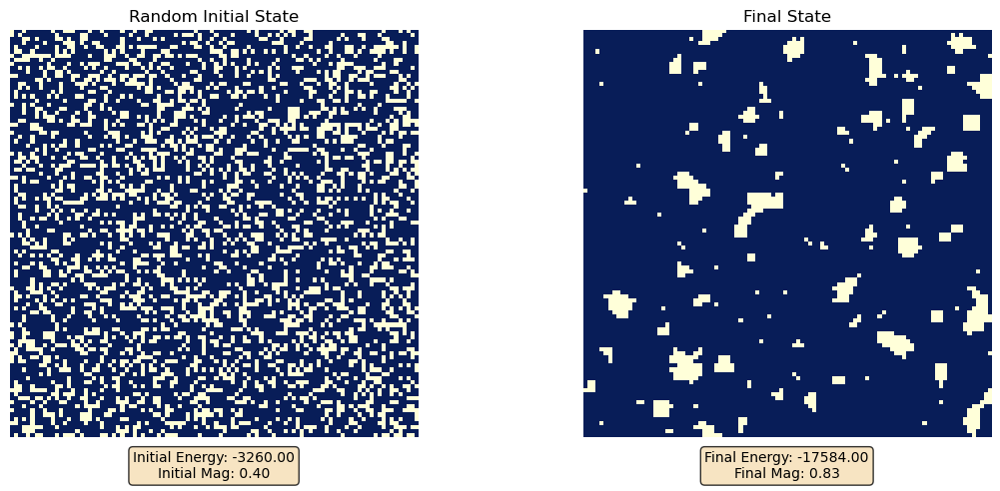

~ Triangluar LATTICE ~
Lattice size: 100 x 100
Coupling strength J: 1.0
Temperature T: 1.5


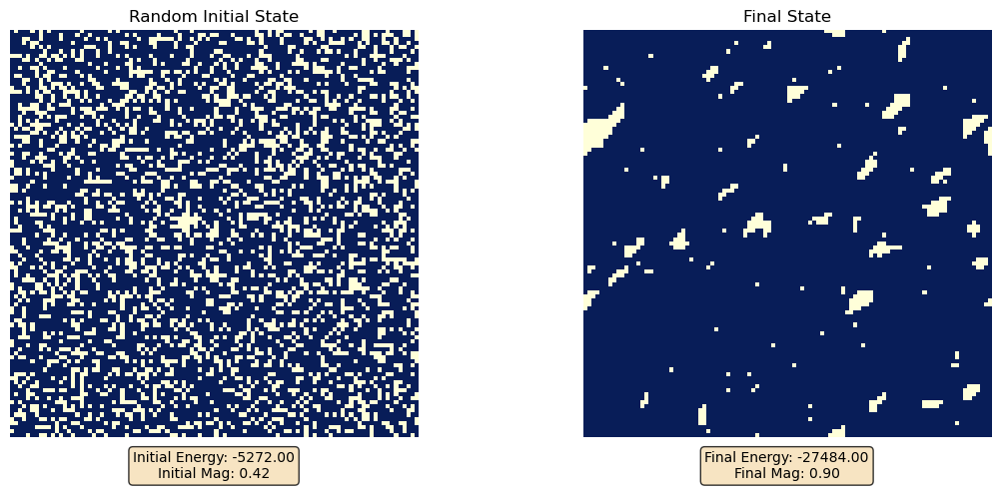

~ Hexagonal LATTICE ~
Lattice size: 100 x 100
Coupling strength J: 1.0
Temperature T: 0.75


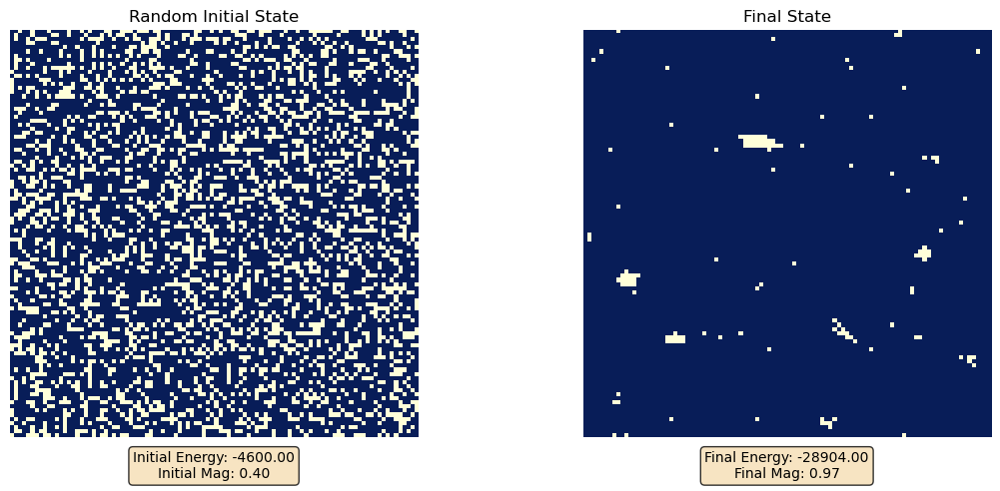

In [ ]:
###---Visualize intial and final state for each lattice type. These Visulaizations are doen using imshow, 
#so they do not distinctly relfect the lattice type. For more accurate visuals, see Ising_with_networkx.ipynb 

def viz_initial_and_final (model, T):
    initial_state = model.initialize_random(spin_up_fraction=0.7)# 70% spin up
    states, energies, mags = model.simulate(temperature=T, n_steps=50000)
    if type(model) == IsingModel:
        name = "Square"
    elif type(model) == IsingModelTriangular:
        name = "Triangluar"
    else:
        name = "Hexagonal"
    
    # Visualize initial and final states
    print(f"~ {name} lattice ~")
    print(f"Lattice size: {model.size} x {model.size}")
    print(f"Coupling strength J: {model.J}")
    print(f"Temperature T: {T}")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    #Initial state
    ax1.imshow(initial_state, cmap='YlGnBu')
    ax1.set_title('Random Initial State', fontsize=12)
    ax1.axis('off')
    initial_text = f"Initial Energy: {energies[0]:.2f}\nInitial Mag: {mags[0]:.2f}"
    ax1.text(0.5, -0.1, initial_text, transform=ax1.transAxes, 
            ha='center', fontsize=10, bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

    #Final state
    ax2.imshow(states[-1], cmap='YlGnBu')
    ax2.set_title('Final State', fontsize=12)
    ax2.axis('off')
    final_mag = model.magnetization(states[-1])
    final_text = f"Final Energy: {energies[-1]:.2f}\nFinal Mag: {abs(final_mag):.2f}"
    ax2.text(0.5, -0.1, final_text, transform=ax2.transAxes, 
            ha='center', fontsize=10, bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

    plt.tight_layout()
    plt.show()

Square = IsingModel(size=100, J=1.0)
viz_initial_and_final(Square, T=1.0)

Triangular = IsingModelTriangular(size=100, J =1.0)
viz_initial_and_final(Triangular, T=1.5)

Hexagonal = IsingModelHexagonal(size=100, J=1.0)
viz_initial_and_final(Hexagonal, T=0.75)


Square lattice


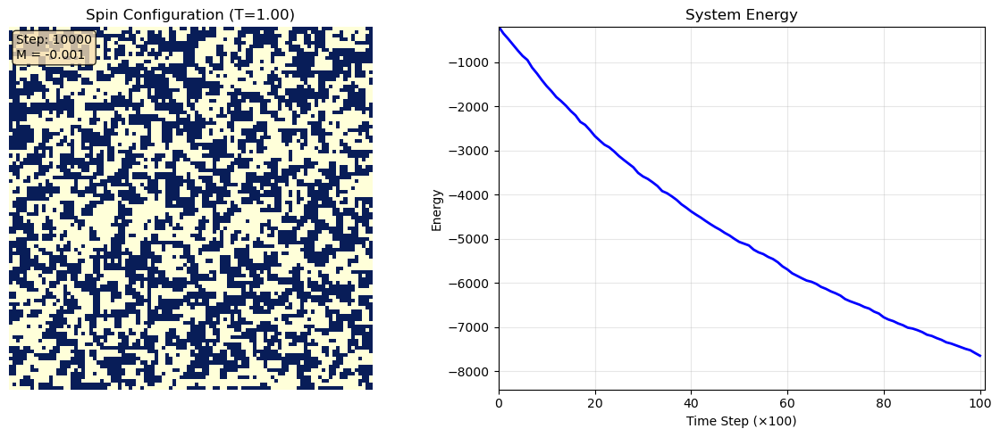

In [9]:
###----Animation of the model's evolution over time

from matplotlib.animation import FuncAnimation
from IPython.display import HTML
def animate_ising(model, size=50, temperature=2.5, n_steps=10000, interval=50):
    """
    Create an animation of the Ising model evolution.

    Parameters:
    -----------
    size : int
    Lattice size
    temperature : float
    Temperature (critical temperature ~2.27)
    n_steps : int
        Number of Monte Carlo steps
    interval : int
    Delay between frames in milliseconds"""

    # Initialize and run simulation
    model.initialize_random()
    states, energies, _ = model.simulate(temperature, n_steps)

    # Set up the figure
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Spin configuration plot
    im = ax1.imshow(states[0], cmap='YlGnBu', vmin=-1, vmax=1, interpolation='nearest')
    ax1.set_title(f'Spin Configuration (T={temperature:.2f})', fontsize=12)
    ax1.axis('off')

    # Energy plot
    energy_line, = ax2.plot([], [], 'b-', linewidth=2)
    ax2.set_xlim(0, len(states))
    ax2.set_ylim(min(energies) * 1.1, max(energies) * 1.1)
    ax2.set_xlabel('Time Step (×100)')
    ax2.set_ylabel('Energy')
    ax2.set_title('System Energy')
    ax2.grid(True, alpha=0.3)

    # Text annotations
    mag_text = ax1.text(0.02, 0.98, '', transform=ax1.transAxes,
                        fontsize=10, verticalalignment='top',
                        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

    def init():
        im.set_data(states[0])
        energy_line.set_data([], [])
        mag_text.set_text('')
        return im, energy_line, mag_text

    def update(frame):
        # Update spin configuration
        im.set_data(states[frame])

        # Update energy plot
        x_data = list(range(frame + 1))
        y_data = energies[:frame + 1]
        energy_line.set_data(x_data, y_data)

        # Update magnetization text
        mag = np.mean(states[frame])
        mag_text.set_text(f'Step: {frame * 100}\nM = {mag:.3f}')

        return im, energy_line, mag_text

    anim = FuncAnimation(fig, update, init_func=init,
                        frames=len(states), interval=interval,
                        blit=True, repeat=True)

    plt.tight_layout()
    return anim

#display animation
Square = IsingModel(size=100, J=1.0)
print("Square lattice")
anim = animate_ising(Square, size=50, temperature=1.0, n_steps=10000)
HTML(anim.to_jshtml())

Triangular lattice


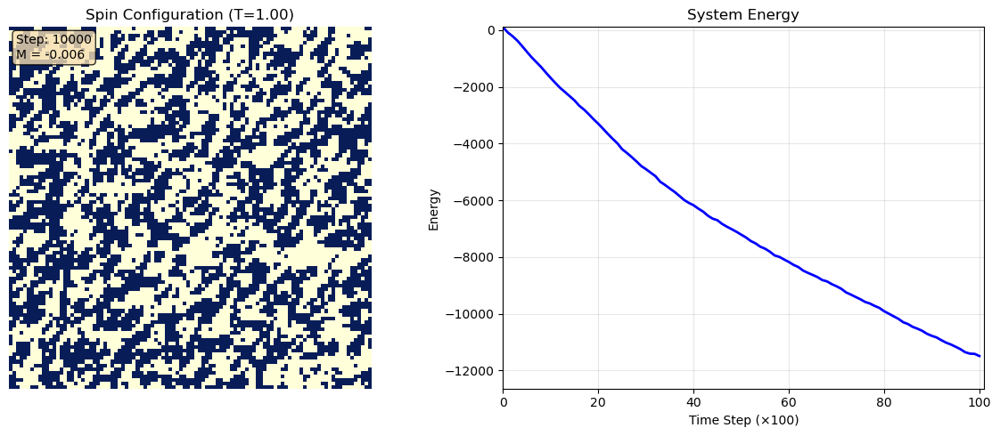

In [10]:
###---Triangular animation
#This is in a separate code cell becuase Jupyter notebooks apparently don't play nice with repeated HTML requests
Triangular = IsingModelTriangular(size=100, J =1.0)
print("Triangular lattice")
anim = animate_ising(Triangular, size=50, temperature=1.0, n_steps=10000)
HTML(anim.to_jshtml())

Hexagonal lattice


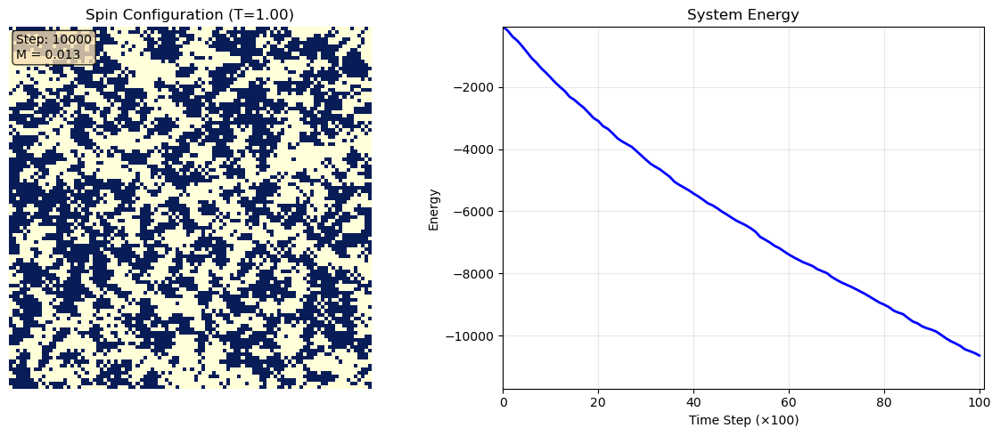

In [12]:
###----Hexagonal animation
Hexagonal = IsingModelHexagonal(size=100, J =1.0)
print("Hexagonal lattice")
anim = animate_ising(Hexagonal, size=50, temperature=1.0, n_steps=10000)
HTML(anim.to_jshtml())


Simulating at T = 0.5
  Final magnetization: 0.938

Simulating at T = 1.5
  Final magnetization: 0.951

Simulating at T = 2.5
  Final magnetization: 0.375

Simulating at T = 4.0
  Final magnetization: 0.034


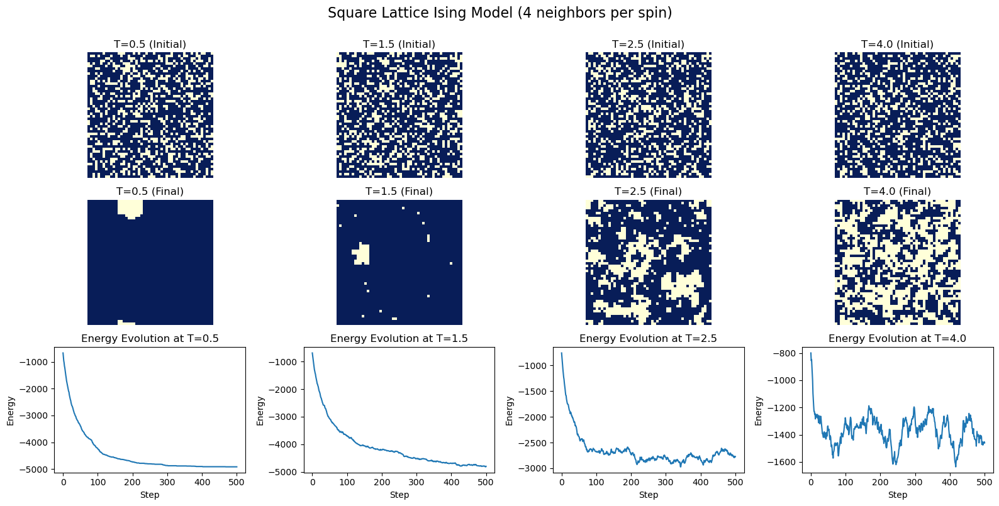


Simulating at T = 0.5
  Final magnetization: 0.999

Simulating at T = 1.5
  Final magnetization: 1.000

Simulating at T = 2.5
  Final magnetization: 0.916

Simulating at T = 4.0
  Final magnetization: 0.256


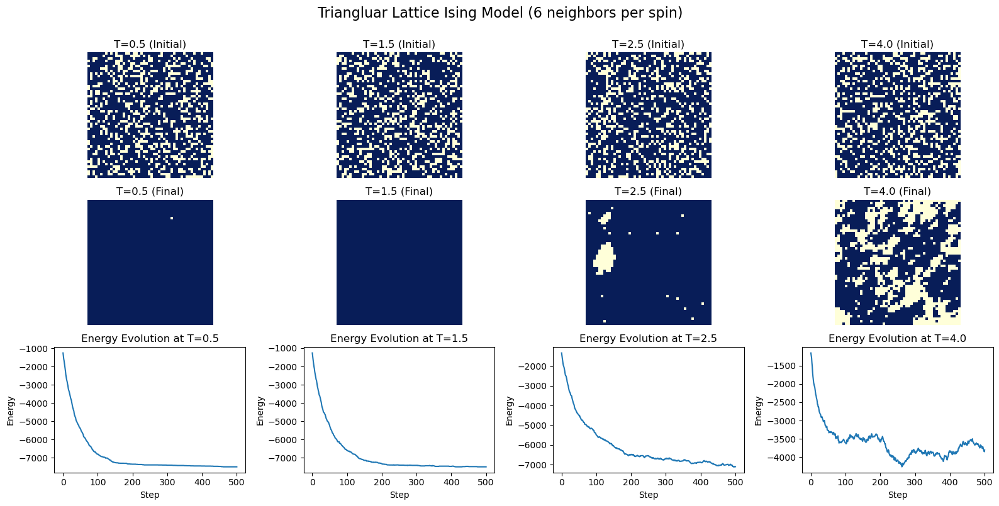


Simulating at T = 0.5
  Final magnetization: 1.000

Simulating at T = 1.5
  Final magnetization: 0.999

Simulating at T = 2.5
  Final magnetization: 0.977

Simulating at T = 4.0
  Final magnetization: 0.558


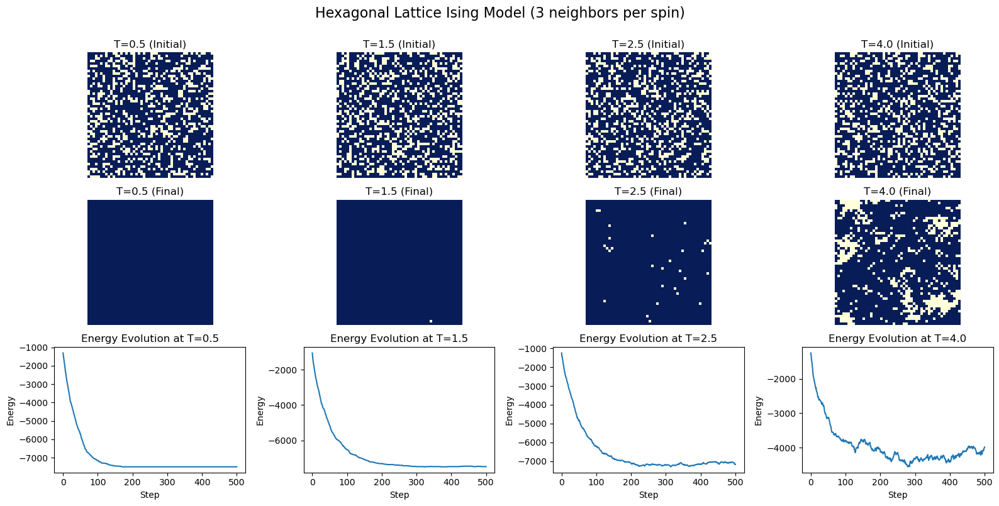

In [ ]:
##VISUALIZE INTIAL AND FINAL STATES FOR MULTIPLE TEMPERATURES

def init_and_final_over_T(model):

    if type(model) == IsingModel:
        name = "Square"
        neighbors = 4
    elif type(model) == IsingModelTriangular:
        name = "Triangluar"
        neighbors = 6
    else:
        name = "Hexagonal"
        neighbors = 3

    temperatures = [0.5, 1.5, 2.5, 4.0]

    fig, axes = plt.subplots(3, 4, figsize=(16, 8))
    fig.suptitle(f'{name} Lattice Ising Model ({neighbors} neighbors per spin)', fontsize=16, y=1.00)

    for idx, T in enumerate(temperatures):
        print(f"\nSimulating at T = {T}")

        initial = model.initialize_random(spin_up_fraction=0.7)

        states, energies, _ = model.simulate(temperature=T, n_steps=50000)

        # Plot initial and final states
        axes[0, idx].imshow(states[0], cmap='YlGnBu', vmin=-1, vmax=1)
        axes[0, idx].set_title(f'T={T:.1f} (Initial)')
        axes[0, idx].axis('off')

        axes[1, idx].imshow(states[-1], cmap='YlGnBu', vmin=-1, vmax=1)
        axes[1, idx].set_title(f'T={T:.1f} (Final)')
        axes[1, idx].axis('off')

        axes[2, idx].plot(energies)
        axes[2, idx].set_xlabel('Step')
        axes[2, idx].set_ylabel('Energy')
        axes[2, idx].set_title(f'Energy Evolution at T={T}')

        final_mag = model.magnetization(states[-1])
        print(f"  Final magnetization: {abs(final_mag):.3f}")

    plt.tight_layout()
    plt.show()

Square = IsingModel(size=50, J=1.0)
init_and_final_over_T(Square)

Triangular = IsingModelTriangular(size=50, J =1.0)
init_and_final_over_T(Triangular)

Hexagonal = IsingModelHexagonal(size=50, J=1.0)
init_and_final_over_T(Hexagonal)

    

Square:


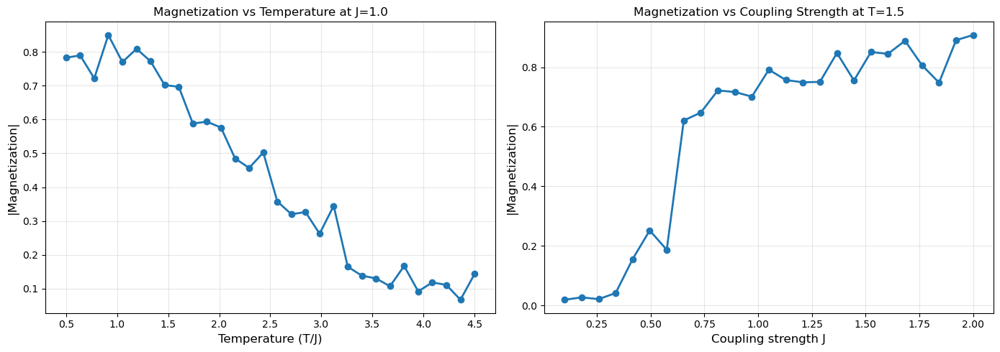

Triangle:


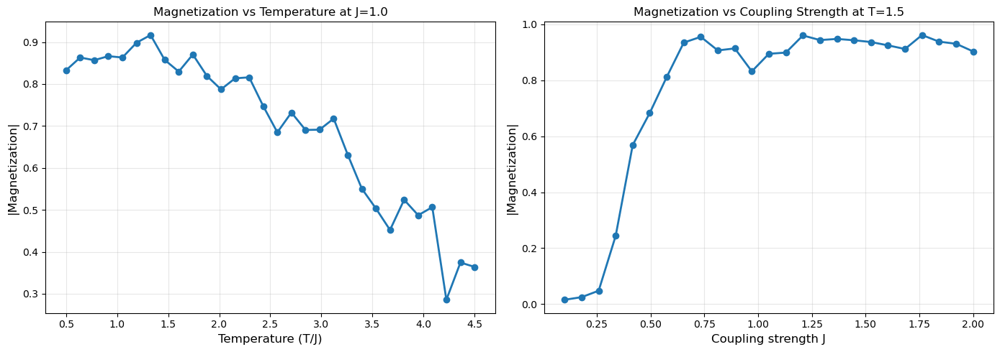

Hex:


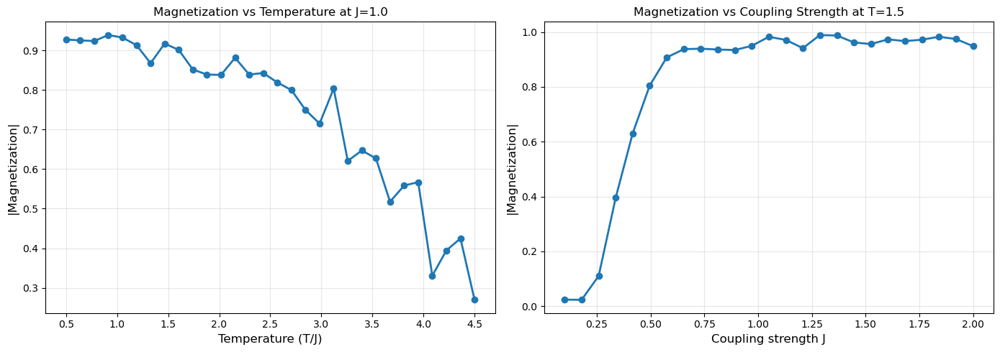

In [17]:
###----SCAN OVER TEMPERATURE, COUPLING STRENGTH
#Beware, this takes a few minutes to run

#See how the overall magnetization is affected by the background temperature by scanning over temperatures
#and find the phase transition
def find_phase_transition(model_type = IsingModel,size=20, temps=None, n_steps=10000, n_equilibration=10000):
    '''Simulate ising with several background temperatures'''
    if temps is None:
        temps = np.linspace(0.5, 4.5, 30)

    magnetizations = []
    for T in temps:
        # print(f"T = {T:.2f}")
        model = model_type(size)
        model.initialize_random(spin_up_fraction=0.7)

        # Run simulation
        states, energies, mags = model.simulate(T, n_steps)

        eq_idx = n_equilibration // 100
        mags_eq = np.array(mags[eq_idx:])

        mean_mag = np.mean(np.abs(mags_eq))
        magnetizations.append(mean_mag)

    return temps, magnetizations

#See how overall magnetization is affeccted by the coupling strength
def find_coupling_transition(model_type = IsingModel, size=20, Js=None, temperature=T, n_steps=20000, n_equilibration=10000):
    """Scan magnetization vs coupling strength J at fixed temperature."""
    if Js is None:
        Js = np.linspace(0.1, 1.5, 20)
    magnetizations = []
    for Jval in Js:
        model = model_type(size, Jval)
        model.initialize_random(spin_up_fraction=0.7)
        states, energies, mags = model.simulate(temperature=temperature, n_steps=n_steps)
        eq_idx = max(0, n_equilibration // 100)  # mags recorded every 100 steps
        mags_eq = np.array(mags[eq_idx:]) if len(mags) > eq_idx else np.array(mags)
        magnetizations.append(np.mean(np.abs(mags_eq)))
    return Js, magnetizations


#Run and display temperature and coupling strength relations
def plot_temp_and_J_scans(model_type, size, J=1.0, n_steps=20000):
    model = model_type(size, J)

    # Run the scans, Change model type to plot different models
    temps, mags = find_phase_transition(model_type, model.size, n_steps=10000, n_equilibration=10000)
    Js, mags_vs_J = find_coupling_transition(model_type, model.size, Js=np.linspace(0.1, 2.0, 25), temperature=1.5, n_steps=20000, n_equilibration=10000)

    # Plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

    # Magnetization vs Temperature
    ax1.plot(temps, mags, 'o-', markersize=6, linewidth=2)
    ax1.set_xlabel('Temperature (T/J)', fontsize=12)
    ax1.set_ylabel('|Magnetization|', fontsize=12)
    ax1.set_title(f'Magnetization vs Temperature at J={J}', fontsize=12)
    ax1.grid(True, alpha=0.3)

    # Magnetization vs Coupling Strength
    ax2.plot(Js, mags_vs_J, 'o-', linewidth=2)
    ax2.set_xlabel('Coupling strength J', fontsize=12)
    ax2.set_ylabel('|Magnetization|', fontsize=12)
    ax2.set_title(f'Magnetization vs Coupling Strength at T={1.5}', fontsize=12)
    ax2.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

print("Square:")
plot_temp_and_J_scans(IsingModel, size=50)
print("Triangle:")
plot_temp_and_J_scans(IsingModelTriangular, size=50)
print("Hex:")
plot_temp_and_J_scans(IsingModelHexagonal, size=50)




Appendix---------

Additionally, there are implementations to create smoother phase transition plots below, with comparrisons to the theoretical values for $T_c$. For the triangular and hexagonal models, this is done by averaging over 30, 500000 step runs. For the square Ising model, this is implemented in numba, for improved eficency. In future versions of this project, the triangular and hexagonal lattices could also be implemented in numba. 

As an aside, comparing the speed of the implentations (numpy, numba, and networkx(in Ising_with_networkx.ipynb)), is an interesting and very tangible look into the computational effiency of different languages.\
Numba: Pre-compiled python (like C++, Rust), very fast\
Numpy: More or less C, wrapped in python, fast for light tasks\
Networkx: Python all the way down, notably slow, even for light tasks

In [ ]:
#plot nicer phase transition, tri
#this takes 1-2 hours to run

temperatures = np.arange(2.9, 4.4, 0.02)
tri_mag = []

avg_tri_mag = np.zeros(76)
for i in range(30):
    for idx, T in enumerate(temperatures):
        print(f"\nSimulating at T = {T}")

        model = IsingModelTriangular(size=50, J=1.0)

        initial = model.initialize_random(spin_up_fraction=0.7)

        states, energies, _ = model.simulate(temperature=T, n_steps=500000)

        final_mag = model.magnetization(states[-1])

        print(f"  Final magnetization: {abs(final_mag):.3f}")
        tri_mag.append(abs(final_mag))
    np.array(tri_mag)    
    avg_tri_mag += tri_mag 
    tri_mag = []
tri_y = avg_tri_mag / 30 

plt.plot(temperatures, tri_y, 'o-', markersize=3, label='MC simulation N=30')
plt.axvline(3.64, color='k', linestyle='--', linewidth=1, label=r'$T_c \approx 3.64$')
plt.xlabel("Temperature T (J/K)")
plt.ylabel("Magnetization |m|")
plt.title("Triangular lattice Phase Transition")
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
#plot nicer phase transition, hex
#this takes 1-2 hours to run

temperatures = np.arange(0.8, 2.3, 0.02)
hex_mag = []

avg_hex_mag = np.zeros(76)
for i in range(30):
    for idx, T in enumerate(temperatures):
        print(f"\nSimulating at T = {T}")

        model = IsingModelHexagonal(size=50, J=1.0)

        initial = model.initialize_random(spin_up_fraction=0.7)

        states, energies, _ = model.simulate(temperature=T, n_steps=500000)

        final_mag = model.magnetization(states[-1])

        print(f"  Final magnetization: {abs(final_mag):.3f}")
        hex_mag.append(abs(final_mag))
    np.array(hex_mag)    
    avg_hex_mag += hex_mag 
    hex_mag = []
hex_y = avg_hex_mag / 30

plt.plot(temperatures, hex_y, 'o-', markersize=3, label='MC simulation N=30')
plt.axvline(1.63, color='k', linestyle='--', linewidth=1, label=r'$T_c \approx 1.63$')
plt.xlabel("Temperature T (J/K)")
plt.ylabel("Magnetization |m|")
plt.title("Hexagonal lattice Phase Transition")
plt.legend()
plt.tight_layout()
plt.show()

Nicer phase transition, square, uses numba\
-> this plot is generated in Ising_in_external_field.ipynb\
-> I include a copy here for your viewing pleasure\
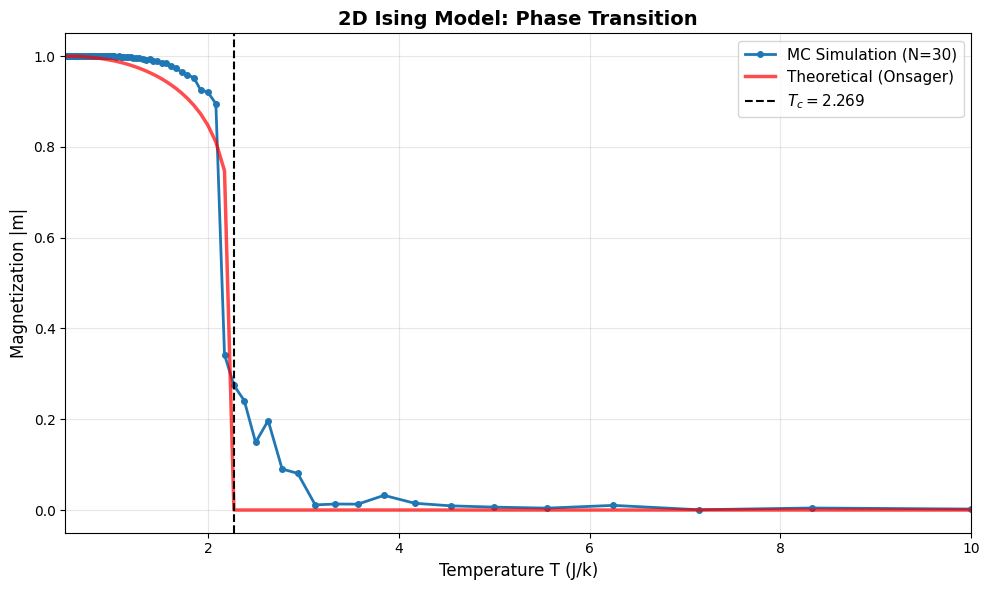